## Initial data load
### Market cap sorted list from CoinGecko
### Daily close price data from Yfinance

In [1]:
import requests
import pandas as pd
import yfinance as yf
import datetime
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import numpy as np

In [2]:
# Initialize stablecoin_symbols to ensure it's always defined
stablecoin_symbols = []

# Get the list of top 100 tickers from CoinGecko
url = "https://api.coingecko.com/api/v3/coins/markets?vs_currency=usd&order=market_cap_desc&per_page=200&page=1"
response = requests.get(url)

if response.status_code == 200:
    data = response.json()
    df = pd.DataFrame(data)
    tickers_df = df[['id', 'symbol', 'market_cap', 'market_cap_rank']]
else:
    print("Failed to fetch data")
    tickers_df = pd.DataFrame()

print(pd.concat([tickers_df.head(), tickers_df.tail()]))
print(tickers_df)

# Fetch categories from CoinGecko
categories_url = "https://api.coingecko.com/api/v3/coins/categories"
response = requests.get(categories_url)

if response.status_code == 200:
    categories_data = response.json()
    # Find the stablecoin category (you might need to adjust the category name)
    stablecoin_category = next((cat for cat in categories_data if 'stablecoin' in cat['name'].lower()), None)
    
    if stablecoin_category:
        # Fetch coins in the stablecoin category
        coins_url = f"https://api.coingecko.com/api/v3/coins/markets?vs_currency=usd&category={stablecoin_category['id']}&order=market_cap_desc&per_page=250&page=1"
        coins_response = requests.get(coins_url)

        if coins_response.status_code == 200:
            coins_data = coins_response.json()
            # Extract coin symbols
            stablecoin_symbols = [coin['symbol'] for coin in coins_data]
            print(stablecoin_symbols)
        else:
            print("Failed to fetch coins in the stablecoin category")
    else:
        print("Stablecoin category not found")
else:
    print("Failed to fetch categories")

# Ensure tickers_df is a DataFrame to prevent AttributeError in case of failed data fetch
if not isinstance(tickers_df, pd.DataFrame):
    tickers_df = pd.DataFrame()

# Filtering tickers excluding stablecoins, handling cases where stablecoin_symbols might be empty
str_tickers = tickers_df[~tickers_df['symbol'].isin(stablecoin_symbols)]
print(str_tickers)

                            id symbol     market_cap  market_cap_rank
0                      bitcoin    btc  1299623619944                1
1                     ethereum    eth   385211680273                2
2                       tether   usdt   109934739171                3
3                  binancecoin    bnb    91861517532                4
4                       solana    sol    69028053323                5
195                   biconomy   bico      418272062              196
196                 degen-base  degen      416663056              197
197                   ontology    ont      415001828              198
198  compound-governance-token   comp      407674219              199
199                 frax-share    fxs      406397431              200
                            id symbol     market_cap  market_cap_rank
0                      bitcoin    btc  1299623619944                1
1                     ethereum    eth   385211680273                2
2                   

In [3]:
# Define the ticker dictionary
# You'll need to manually update this dictionary with the correct mappings
ticker_dict = {
    'imx': 'IMX10603',
    'grt': 'GRT6719',
    'pepe': 'PEPE24478',
    'tao' : 'TAO22974',
    'axl' : 'AXL17799',
    'mnt' : 'MNT27075',
    'ron' : 'RON14101',
    'super' : 'SUPER8290',
    'nft' : 'NFT9816',
    'brett' : 'BRETT29743',
    'sats' : '1000SATS',
    'mew' : 'MEW30126',
    'gmt' : 'GMT18069',
    'comp' : 'COMP5692',
    'luna' : 'LUNA20314',
    'alt' : 'ALT29073',
    'degen' : 'DEGEN30096',
    'mask' : 'MASK8536',
    'arb' : 'ARB11841',
    'uni' : 'UNI7083',
    'ton' : 'TON11419',
    'tia' : 'TIA22861'
    
    
    
    
    # Add more mappings here
}
str_tickers.loc[:, 'symbol'] = str_tickers['symbol'].apply(lambda x: ticker_dict.get(x.lower(), x))
print(str_tickers)

                            id      symbol     market_cap  market_cap_rank
0                      bitcoin         btc  1299623619944                1
1                     ethereum         eth   385211680273                2
3                  binancecoin         bnb    91861517532                4
4                       solana         sol    69028053323                5
6                 staked-ether       steth    29942386633                7
..                         ...         ...            ...              ...
195                   biconomy        bico      418272062              196
196                 degen-base  DEGEN30096      416663056              197
197                   ontology         ont      415001828              198
198  compound-governance-token    COMP5692      407674219              199
199                 frax-share         fxs      406397431              200

[190 rows x 4 columns]


C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\353689691.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  str_tickers.loc[:, 'symbol'] = str_tickers['symbol'].apply(lambda x: ticker_dict.get(x.lower(), x))


In [4]:
# Need to format the tickers in a new column so they can be ingested by the yfinance 
# yf.download function.
# This requires the tickers to be in the format XXX-USD. They also need to be copied to a 
# new df where they will be in string format sperated by a space ' '.

str_tickers['formatted_symbol'] = str_tickers['symbol'].str.upper() + '-USD'
print(str_tickers)

str_tickers = ' '.join(str_tickers['formatted_symbol'])
print(str_tickers)

                            id      symbol     market_cap  market_cap_rank  \
0                      bitcoin         btc  1299623619944                1   
1                     ethereum         eth   385211680273                2   
3                  binancecoin         bnb    91861517532                4   
4                       solana         sol    69028053323                5   
6                 staked-ether       steth    29942386633                7   
..                         ...         ...            ...              ...   
195                   biconomy        bico      418272062              196   
196                 degen-base  DEGEN30096      416663056              197   
197                   ontology         ont      415001828              198   
198  compound-governance-token    COMP5692      407674219              199   
199                 frax-share         fxs      406397431              200   

    formatted_symbol  
0            BTC-USD  
1            ETH-

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\83930062.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  str_tickers['formatted_symbol'] = str_tickers['symbol'].str.upper() + '-USD'


In [5]:
def get_close_price(symbol):
    # Calculate the start date as 201 days before today
    today = datetime.datetime.now()
    start_date = today - datetime.timedelta(days=1000)
    
    # Increment the end date by one day to include today's data
    end_date = today + datetime.timedelta(days=1)
    
    # Format dates in YYYY-MM-DD format
    start_date = start_date.strftime('%Y-%m-%d')
    end_date = end_date.strftime('%Y-%m-%d')
    
    # Download historical data for the specified symbol and date range
    data = yf.download(symbol, start=start_date, end=end_date, actions=False)
    close_prices = data['Close']
    return close_prices

close_data = get_close_price(str_tickers)
print(close_data)

[*********************100%%**********************]  190 of 190 completed


Ticker      1000SATS-USD  1INCH-USD    AAVE-USD   ADA-USD  AERO-USD  AGIX-USD  \
Date                                                                            
2021-07-27           NaN   2.216388  300.003143  1.278446       NaN  0.196548   
2021-07-28           NaN   2.182685  297.069275  1.283504       NaN  0.186687   
2021-07-29           NaN   2.240915  311.398132  1.284084       NaN  0.208014   
2021-07-30           NaN   2.310948  321.565247  1.308952       NaN  0.206301   
2021-07-31           NaN   2.383902  331.018280  1.322345       NaN  0.218875   
...                  ...        ...         ...       ...       ...       ...   
2024-04-18      0.000265   0.407175   85.444984  0.458144  0.005481  0.841483   
2024-04-19      0.000275   0.415018   85.900520  0.468784  0.005248  0.865329   
2024-04-20      0.000377   0.442367   91.781418  0.505908  0.005581  0.999918   
2024-04-21      0.000340   0.428431   91.024483  0.499292  0.005614  0.980098   
2024-04-22      0.000371   0

In [6]:
# Assuming 'df' is your pandas DataFrame
columns_with_nans = close_data.columns[close_data.isnull().any()]
print(columns_with_nans)

Index(['1000SATS-USD', 'AERO-USD', 'ALT29073-USD', 'APT-USD', 'ARB11841-USD',
       'ARKM-USD', 'ASTR-USD', 'AXL17799-USD', 'BGB-USD', 'BICO-USD',
       'BLUR-USD', 'BODEN-USD', 'BOME-USD', 'BONK-USD', 'BRETT29743-USD',
       'CBETH-USD', 'CHEEL-USD', 'CORGIAI-USD', 'DEGEN30096-USD', 'DYDX-USD',
       'DYM-USD', 'EETH-USD', 'ENA-USD', 'ENS-USD', 'ETHDYDX-USD', 'ETHFI-USD',
       'ETHW-USD', 'EZETH-USD', 'FLOKI-USD', 'FLR-USD', 'FRXETH-USD',
       'FTN-USD', 'GALA-USD', 'GMT18069-USD', 'IMX10603-USD', 'IOTA-USD',
       'JTO-USD', 'KAS-USD', 'LUNA20314-USD', 'MANTA-USD', 'METH-USD',
       'MEW30126-USD', 'MNT27075-USD', 'MSOL-USD', 'ONDO-USD', 'OP-USD',
       'ORDI-USD', 'OSMO-USD', 'PEPE24478-USD', 'POLYX-USD', 'PRIME-USD',
       'PYTH-USD', 'RBN-USD', 'RETH-USD', 'RON14101-USD', 'RSETH-USD',
       'SEI-USD', 'SFRXETH-USD', 'STSOL-USD', 'SUI-USD', 'SWETH-USD',
       'TAO22974-USD', 'TIA22861-USD', 'TON11419-USD', 'VENOM-USD', 'W-USD',
       'WBT-USD', 'WEETH-USD', 'WIF-USD'

In [7]:
#close_data = close_data.drop(['EETH-USD', 'METH-USD','ENA-USD', 'W-USD'], axis=1)

In [8]:
sma_50 = pd.DataFrame(index=close_data.index)
sma_100 = pd.DataFrame(index=close_data.index)
sma_200 = pd.DataFrame(index=close_data.index)

# Calculate SMAs for each symbol
for symbol in close_data:
    sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
    sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
    sma_200[symbol] = close_data[symbol].rolling(window=200).mean()

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.inser

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_200[symbol] = close_data[symbol].rolling(window=200).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.ins

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.inser

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_200[symbol] = close_data[symbol].rolling(window=200).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.inser

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.inser

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.inser

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_200[symbol] = close_data[symbol].rolling(window=200).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.ins

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_200[symbol] = close_data[symbol].rolling(window=200).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.ins

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_200[symbol] = close_data[symbol].rolling(window=200).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.ins

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.inser

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_200[symbol] = close_data[symbol].rolling(window=200).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.ins

C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_50[symbol] = close_data[symbol].rolling(window=50).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sma_100[symbol] = close_data[symbol].rolling(window=100).mean()
C:\Users\James_Rig\AppData\Local\Temp\ipykernel_23376\1994399382.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.inser

In [9]:
def calculate_percentage_above(df_sma, close_data):
    # Initialize a Series to hold the percentage of coins above SMA for each date
    percentage_above = pd.Series(index=df_sma.index, dtype=float)
    
    # Iterate over each day
    for date in df_sma.index:
        num_coins = 0  # Number of coins above SMA
        for coin in close_data.columns:
            # Check if the close price is above the SMA for each coin
            if close_data.at[date, coin] > df_sma.at[date, coin]:
                num_coins += 1
        # Calculate the percentage
        percentage_above[date] = (num_coins / len(close_data.columns)) * 100
        
    return percentage_above

# Calculate percentages for each SMA period
percentage_above_50 = calculate_percentage_above(sma_50, close_data)
percentage_above_100 = calculate_percentage_above(sma_100, close_data)
percentage_above_200 = calculate_percentage_above(sma_200, close_data)


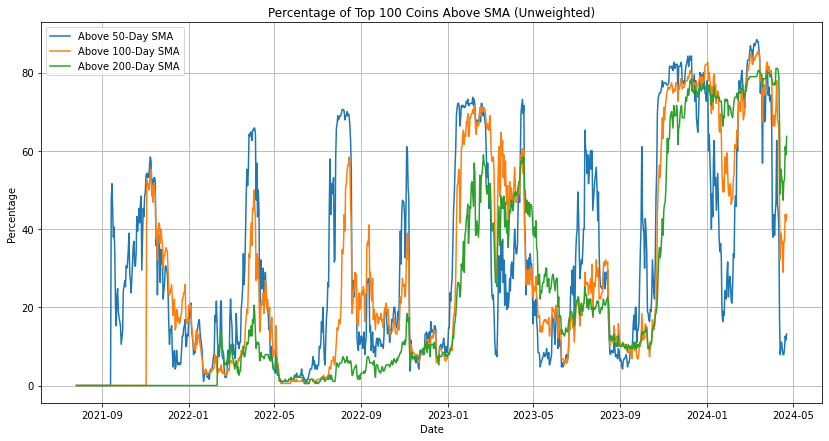

In [10]:
import matplotlib.pyplot as plt

plt.figure(figsize=(14, 7))
plt.plot(percentage_above_50.index, percentage_above_50, label='Above 50-Day SMA')
plt.plot(percentage_above_100.index, percentage_above_100, label='Above 100-Day SMA')
plt.plot(percentage_above_200.index, percentage_above_200, label='Above 200-Day SMA')

plt.title('Percentage of Top 100 Coins Above SMA (Unweighted)')
plt.xlabel('Date')
plt.ylabel('Percentage')
plt.legend()
plt.grid(True)
plt.show()

import plotly.graph_objects as go

# Create a line for each SMA percentage
trace1 = go.Scatter(x=percentage_above_50.index, y=percentage_above_50, mode='lines', name='Above 50-Day SMA')
trace2 = go.Scatter(x=percentage_above_100.index, y=percentage_above_100, mode='lines', name='Above 100-Day SMA')
trace3 = go.Scatter(x=percentage_above_200.index, y=percentage_above_200, mode='lines', name='Above 200-Day SMA')

# Create the figure and add traces
fig = go.Figure(data=[trace1, trace2, trace3])

# Update layout for a more informative chart
fig.update_layout(title='Percentage of Top 100 Coins Above SMA (Unweighted)',
                  xaxis_title='Date',
                  yaxis_title='Percentage',
                  hovermode='x unified')

# Show the figure
fig.show()

## Ticker screener 
### Moving averages
### Breakouts

In [11]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Assuming 'close_date' is your dataframe with assets as columns and dates as the index

# Calculate the 20-day moving average excluding today's price
moving_average = close_data.shift(1).rolling(window=20).mean()

# Create a figure with subplots for each asset that is above its 20-day moving average
assets_above_average = close_data.columns[(close_data.iloc[-1] > moving_average.iloc[-1])]

# Setting up the number of plots per row
plots_per_row = 3
num_rows = (len(assets_above_average) + plots_per_row - 1) // plots_per_row

fig = make_subplots(rows=num_rows, cols=plots_per_row, subplot_titles=assets_above_average)

# Position tracker for subplots
row, col = 1, 1

for asset in assets_above_average:
    # Add the close price trace
    fig.add_trace(
        go.Scatter(x=close_data.index, y=close_data[asset], mode='lines', name=f'{asset} Close Price'),
        row=row, col=col
    )
    # Add the moving average trace
    fig.add_trace(
        go.Scatter(x=moving_average.index, y=moving_average[asset], mode='lines', name=f'{asset} 20-Day MA'),
        row=row, col=col
    )

    # Update col and row indices for next subplot
    col += 1
    if col > plots_per_row:
        col = 1
        row += 1

# Update layout settings
fig.update_layout(height=300*num_rows, width=1000, title_text="Assets Above 20-Day Moving Average with Their Moving Averages")
fig.show()


In [12]:
rolling_highs = close_data.shift(1).rolling(window=20).max()
rolling_highs

Ticker,1000SATS-USD,1INCH-USD,AAVE-USD,ADA-USD,AERO-USD,AGIX-USD,AIOZ-USD,AKT-USD,ALGO-USD,ALT29073-USD,...,XDC-USD,XEC-USD,XLM-USD,XMR-USD,XRD-USD,XRP-USD,XTZ-USD,ZBC-USD,ZIL-USD,ZRX-USD
Date,,,,,,,,,,,,,,,,,,,,,
2021-07-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-07-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-07-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-07-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-07-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-18,0.000552,0.618345,129.189789,0.664403,0.006068,1.314976,0.940799,5.171474,0.268480,0.638478,...,0.050015,0.00008,0.142863,136.760666,0.077301,0.630750,1.419037,0.040593,0.038942,0.861397
2024-04-19,0.000552,0.618345,129.189789,0.650427,0.006068,1.304881,0.940799,4.896176,0.267922,0.638478,...,0.050015,0.00008,0.141118,136.760666,0.077301,0.629225,1.401070,0.037361,0.038942,0.776366
2024-04-20,0.000552,0.618345,129.189789,0.650427,0.006068,1.265884,0.940799,4.787286,0.267922,0.638478,...,0.050015,0.00008,0.141118,136.760666,0.077301,0.629225,1.401070,0.037361,0.038942,0.760101


In [13]:
latest_closes = close_data.iloc[-1]
above_20_day_high = latest_closes[latest_closes > rolling_highs.iloc[-1]]

# Print the coins above their 20-day high
print(above_20_day_high)

Ticker
FTN-USD    1.875701
ONT-USD    0.462175
WBT-USD    9.870176
Name: 2024-04-22 00:00:00, dtype: float64


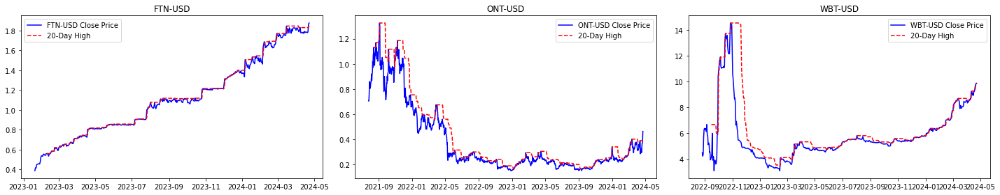

In [14]:
# Filter 'close_data' to include only the coins above their 20-day high
coins_to_plot = close_data[above_20_day_high.index]

# Setup the figure and axes for the subplot grid
num_coins = len(coins_to_plot.columns)
nrows = (num_coins // 5) + (1 if num_coins % 5 > 0 else 0)  # Ensure enough rows to accommodate all coins
fig, axes = plt.subplots(nrows=nrows, ncols=min(num_coins, 5), figsize=(20, nrows * 4), squeeze=False)
axes = axes.flatten()

# Plot each coin's data
for i, coin_name in enumerate(coins_to_plot.columns):
    coin_data = coins_to_plot[coin_name]
    rolling_high_data = rolling_highs[coin_name]
    
    # Plot close prices
    axes[i].plot(coin_data.index, coin_data, label=f'{coin_name} Close Price', color='blue')
    
    # Plot 20-day rolling high
    axes[i].plot(rolling_high_data.index, rolling_high_data, label='20-Day High', color='red', linestyle='--')
    
    axes[i].set_title(coin_name)
    axes[i].legend()

# Hide unused subplots if any
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

In [15]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

# Assuming 'close_data' and 'rolling_highs' are your datasets

# Calculate the latest date in your dataset
latest_date = close_data.index.max()

# Calculate the start date 30 days before the latest date
start_date = latest_date - pd.Timedelta(days=30)

# Setup the figure and axes for the subplot grid, continued from previous example...

fig = make_subplots(rows=nrows, cols=min(num_coins, 5), subplot_titles=coins_to_plot.columns)
current_row = 1
current_col = 1

for i, coin_name in enumerate(coins_to_plot.columns):
    coin_data = coins_to_plot[coin_name]
    rolling_high_data = rolling_highs[coin_name]
    
    fig.add_trace(go.Scatter(x=coin_data.index, y=coin_data, mode='lines', name=f'{coin_name} Close Price'), row=current_row, col=current_col)
    fig.add_trace(go.Scatter(x=rolling_high_data.index, y=rolling_high_data, mode='lines', name='20-Day High', line=dict(dash='dash')), row=current_row, col=current_col)
    
    # Move to the next subplot location
    current_col += 1
    if current_col > min(num_coins, 5):
        current_col = 1
        current_row += 1

# After all traces are added, update the x-axis range for all subplots to the last 30 days
fig.update_xaxes(range=[start_date, latest_date])

# Update layout if necessary
fig.update_layout(height=300 * nrows, showlegend=True, title_text="Cryptocurrency 20-Day High Breakouts")

fig.show()


In [16]:
# Assuming `df` is your DataFrame with dates as index and asset tickers as columns
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming 'breaking_assets' contains the list of assets breaking above their 20-day MA in the last 5 days
# Limit to the first 25 for a 5x5 grid, or fewer if less available

# Calculate the 20-day moving average
moving_averages = close_data.rolling(window=20).mean()
# Get the last 5 days
last_5_days_close = close_data.tail(5)
last_5_days_ma = moving_averages.tail(5)

# Find where the close is greater than the MA in the last 5 days
breaking_above_ma = (last_5_days_close > last_5_days_ma)

# Identify the assets that have broken above the MA in the last 5 days
# Sum across rows to find days where condition is True, then check if sum > 0
assets_breaking_above = breaking_above_ma.apply(lambda x: x.sum() > 0, axis=0)

# List of assets that have broken above their 20-day MA in the last 5 days
breaking_assets = assets_breaking_above[assets_breaking_above].index.tolist()


In [17]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming 'breaking_assets' contains the list of assets breaking above their 20-day MA in the last 5 days
# Limit to the first 25 for a 5x5 grid, or fewer if less available
breaking_assets_to_plot = breaking_assets[:25]
num_assets = len(breaking_assets_to_plot)

# Determine the grid size
grid_size = int(np.ceil(np.sqrt(num_assets)))  # This ensures a square layout that fits all assets

# Create a subplot grid
fig = make_subplots(rows=grid_size, cols=grid_size, subplot_titles=breaking_assets_to_plot)

# Variables to keep track of which subplot to fill next
row = 1
col = 1

for asset in breaking_assets_to_plot:
    # Add closing price line to subplot
    fig.add_trace(go.Scatter(x=close_data.index, y=close_data[asset], mode='lines', name=f'{asset} Close Price'), row=row, col=col)
    # Add 20-day MA line to subplot
    fig.add_trace(go.Scatter(x=moving_averages.index, y=moving_averages[asset], mode='lines', name='20-Day MA'), row=row, col=col)

    # Update subplot position
    col += 1
    if col > grid_size:
        col = 1
        row += 1

# Update layout to make it cleaner and set titles
fig.update_layout(height=2000, width=2000, title_text="Assets Breaking Above 20-Day MA in Last 5 Days", showlegend=False)

fig.show()


## Trend Scanner 
### Clenow momentum - exponential regression of prices

#### 30 day momentum

In [18]:
import numpy as np
from scipy.stats import linregress

# Define the lookback period, the number of trading days, and the number of days to exclude
lookback_period = 30
trading_days = 365
exclude_days = 5

# Assuming close_data is your DataFrame containing stock prices with tickers as column names

# Modified function to calculate both momentum score and R-squared
def calculate_momentum_score_and_r2(prices):
    log_prices = np.log(prices)
    slope, _, r_value, _, _ = linregress(range(len(log_prices)), log_prices)
    momentum_score = (1 + slope)**trading_days * r_value**2
    return momentum_score, r_value**2

# Iterate over each ticker column and calculate the momentum score and R-squared value
momentum_scores_and_r2 = {}
for ticker in close_data.columns:
    prices = close_data[ticker].dropna()
    
    # Select the prices for the regression, excluding the last 'exclude_days' days
    regression_prices = prices[:-exclude_days][-lookback_period:]
    
    # Get both momentum score and R-squared for the ticker
    momentum_score, r_squared = calculate_momentum_score_and_r2(regression_prices)
    
    # Store in the dictionary
    momentum_scores_and_r2[ticker] = (momentum_score, r_squared)


C:\Users\James_Rig\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning:

divide by zero encountered in log

C:\Users\James_Rig\anaconda3\lib\site-packages\numpy\lib\function_base.py:2536: RuntimeWarning:

invalid value encountered in subtract



In [19]:
# Sort the momentum scores in descending order
sorted_momentum_scores = sorted(momentum_scores_and_r2.items(), key=lambda x: x[1], reverse=True)
print(sorted_momentum_scores)

[('BODEN-USD', (166897947.61553606, 0.7477282112068936)), ('BRETT29743-USD', (30436.446461597694, 0.5619817254164378)), ('TON11419-USD', (283.26799974672986, 0.7800320130781881)), ('NEO-USD', (40.107353712797874, 0.5339767152309829)), ('NFT9816-USD', (nan, nan)), ('PENDLE-USD', (61391.12593914487, 0.8199284064511004)), ('BGB-USD', (112.38763799773469, 0.7114377873955284)), ('MNT27075-USD', (75.91850090670013, 0.4110020045797114)), ('MX-USD', (53.60301707304454, 0.7936824831404513)), ('MEW30126-USD', (22.66993332798215, 0.05326568242714653)), ('CKB-USD', (17.466777436361514, 0.28865160574996224)), ('OM-USD', (10.00605141162204, 0.3621652467431298)), ('WBT-USD', (4.98924280527004, 0.8611341206886256)), ('BCH-USD', (4.253999064337541, 0.17675726845190556)), ('APT-USD', (3.8461664272597096, 0.49162185038818773)), ('TFUEL-USD', (2.4588765867584548, 0.24431173486486524)), ('RVN-USD', (0.6466159929044216, 0.05993127083504648)), ('BICO-USD', (0.28421749307367433, 0.051897507091182925)), ('LEO-

C:\Users\James_Rig\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning:

divide by zero encountered in log

C:\Users\James_Rig\anaconda3\lib\site-packages\numpy\lib\function_base.py:2536: RuntimeWarning:

invalid value encountered in subtract



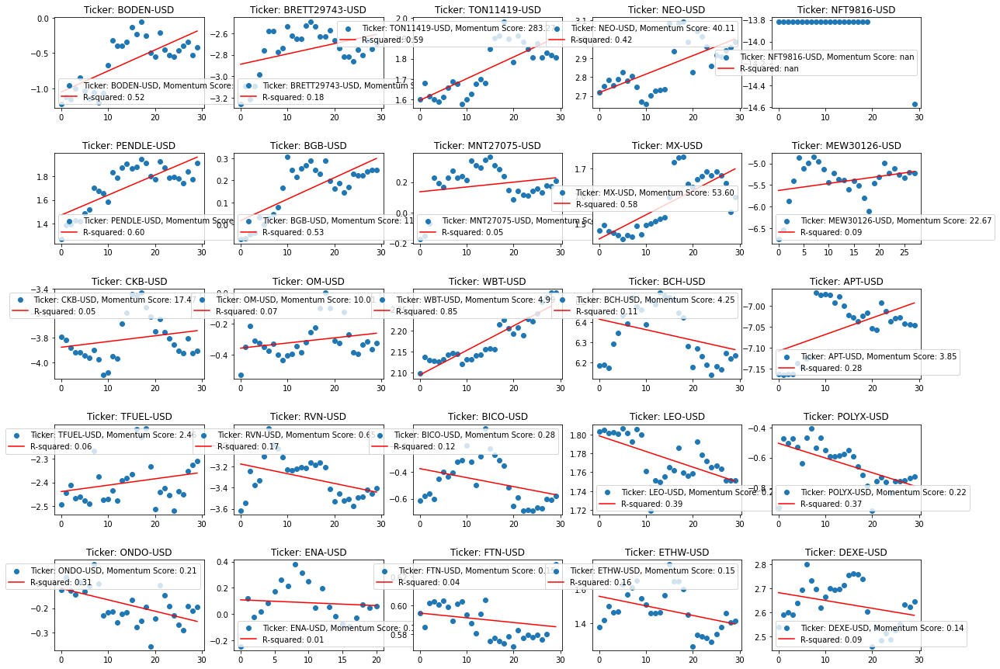

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a figure with subplots
fig, axs = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
axs = axs.ravel()  # Flatten the array of subplots

# Iterate over the sorted momentum scores and plot the scatter plots
for i, (ticker, score) in enumerate(sorted_momentum_scores[:25]):
    prices = close_data[ticker].dropna()[-lookback_period:]
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = range(len(log_prices))
    y_fit = [slope * xi + intercept for xi in x]
    
    # Plot the scatter plot and the r-squared line
    # Plot the scatter plot and the r-squared line
    ax = axs[i]
    ax.scatter(x, log_prices, label=f'Ticker: {ticker}, Momentum Score: {score[0]:.2f}')
    ax.plot(x, y_fit, 'r-', label=f'R-squared: {linregress(x, log_prices)[2]**2:.2f}')
    ax.set_title(f'Ticker: {ticker}')
    ax.legend()


# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.5)

# Show the plot
plt.show()

In [21]:
# Assuming momentum_scores_and_r2 is defined and populated as shown in the Cell 1 code

# Sort the momentum_scores_and_r2 dictionary by R-squared values in descending order
sorted_by_r2 = sorted(momentum_scores_and_r2.items(), key=lambda x: x[1][1], reverse=True)


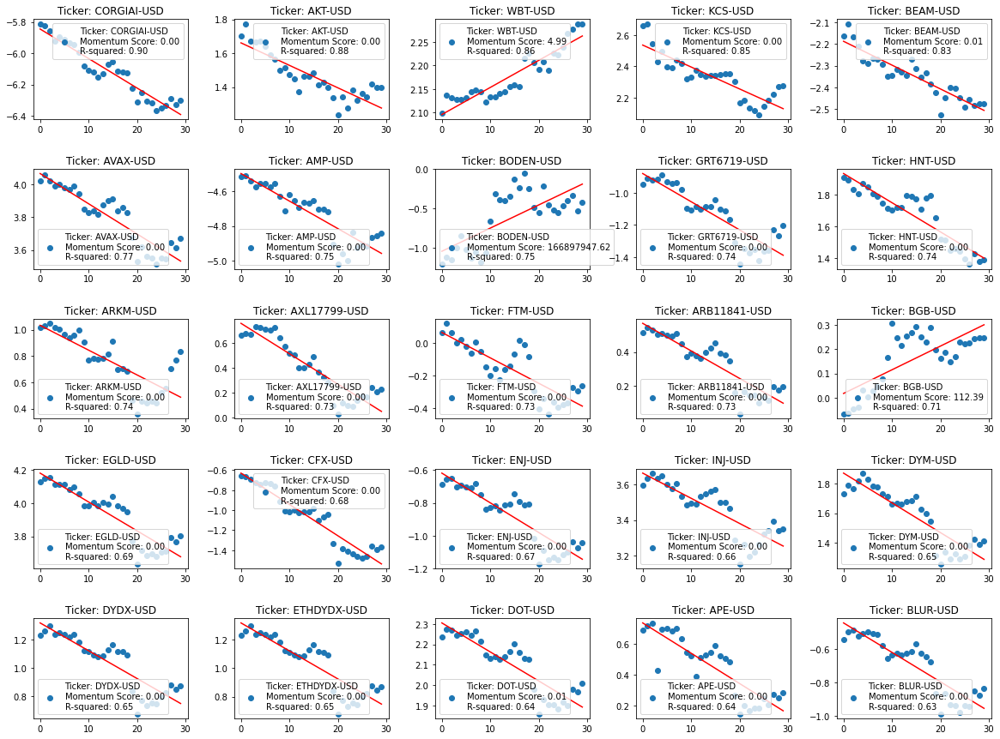

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming close_data and lookback_period are defined as per your original setup

# Create a figure with subplots
fig, axs = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
axs = axs.ravel()  # Flatten the array of subplots

# Iterate over the sorted R-squared scores and plot the scatter plots for the top 25
for i, (ticker, (score, r_squared)) in enumerate(sorted_by_r2[:25]):
    prices = close_data[ticker].dropna()[-lookback_period:]
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = np.array(range(len(log_prices)))
    y_fit = slope * x + intercept
    
    # Plot the scatter plot and the regression line
    ax = axs[i]
    ax.scatter(x, log_prices, label=f'Ticker: {ticker}\nMomentum Score: {score:.2f}\nR-squared: {r_squared:.2f}')
    ax.plot(x, y_fit, 'r-')  # Red line for the linear regression
    ax.set_title(f'Ticker: {ticker}')
    ax.legend()

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.3)

# Show the plot
plt.show()

### 45 day momentum

In [23]:
import numpy as np
from scipy.stats import linregress

# Define the lookback period, the number of trading days, and the number of days to exclude
lookback_period = 45
trading_days = 365
exclude_days = 7

# Assuming close_data is your DataFrame containing stock prices with tickers as column names

# Modified function to calculate both momentum score and R-squared
def calculate_momentum_score_and_r2(prices):
    log_prices = np.log(prices)
    slope, _, r_value, _, _ = linregress(range(len(log_prices)), log_prices)
    momentum_score = (1 + slope)**trading_days * r_value**2
    return momentum_score, r_value**2

# Iterate over each ticker column and calculate the momentum score and R-squared value
momentum_scores_and_r2 = {}
for ticker in close_data.columns:
    prices = close_data[ticker].dropna()
    
    # Select the prices for the regression, excluding the last 'exclude_days' days
    regression_prices = prices[:-exclude_days][-lookback_period:]
    
    # Get both momentum score and R-squared for the ticker
    momentum_score, r_squared = calculate_momentum_score_and_r2(regression_prices)
    
    # Store in the dictionary
    momentum_scores_and_r2[ticker] = (momentum_score, r_squared)

# Sort the momentum scores in descending order
sorted_momentum_scores = sorted(momentum_scores_and_r2.items(), key=lambda x: x[1], reverse=True)
print(sorted_momentum_scores)

[('BODEN-USD', (553179889897.377, 0.8690199820194104)), ('BRETT29743-USD', (75526.97608721723, 0.7089894929308176)), ('DEXE-USD', (267.28649373361134, 0.7031973384245525)), ('ENA-USD', (262.72891736340574, 0.2524508752262291)), ('AIOZ-USD', (114.91158099200136, 0.32190750694974074)), ('BGB-USD', (27.9658921428673, 0.727405964574453)), ('BCH-USD', (23.095681785453714, 0.5074447353711544)), ('GT-USD', (15.745057502387006, 0.43391417452133707)), ('DEGEN30096-USD', (7.361807463674093, 0.05745909719191051)), ('JTO-USD', (5.296059186902215, 0.3628761986230384)), ('BNB-USD', (4.029191081505415, 0.4488294293142398)), ('CKB-USD', (3.8600248197346057, 0.27754978987328577)), ('AMP-USD', (2.666829200127522, 0.13236636486405826)), ('BICO-USD', (1.3447480083688528, 0.1932370414745257)), ('ETHFI-USD', (1.0844164665672684, 0.07187043807249731)), ('DOGE-USD', (0.9092751179044769, 0.1992557758068693)), ('ANKR-USD', (0.9050013442308733, 0.17012141992952515)), ('ICP-USD', (0.49280605315268877, 0.118979939

C:\Users\James_Rig\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning:

divide by zero encountered in log

C:\Users\James_Rig\anaconda3\lib\site-packages\numpy\lib\function_base.py:2536: RuntimeWarning:

invalid value encountered in subtract



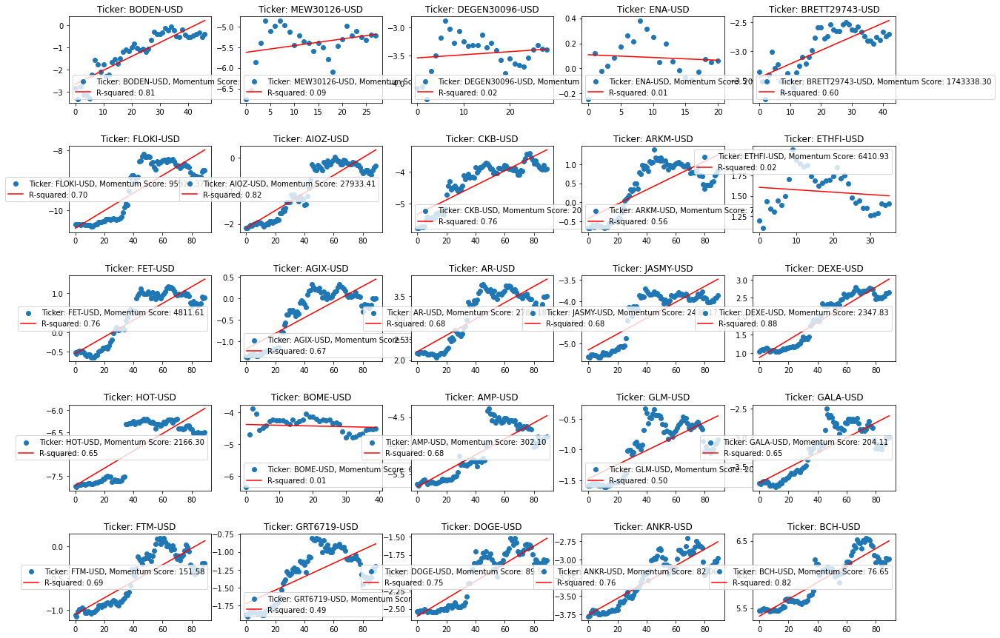

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a figure with subplots
fig, axs = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
axs = axs.ravel()  # Flatten the array of subplots

# Iterate over the sorted momentum scores and plot the scatter plots
for i, (ticker, score) in enumerate(sorted_momentum_scores[:25]):
    prices = close_data[ticker].dropna()[-lookback_period:]
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = range(len(log_prices))
    y_fit = [slope * xi + intercept for xi in x]
    
    # Plot the scatter plot and the r-squared line
    # Plot the scatter plot and the r-squared line
    ax = axs[i]
    ax.scatter(x, log_prices, label=f'Ticker: {ticker}, Momentum Score: {score[0]:.2f}')
    ax.plot(x, y_fit, 'r-', label=f'R-squared: {linregress(x, log_prices)[2]**2:.2f}')
    ax.set_title(f'Ticker: {ticker}')
    ax.legend()


# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.5)

# Show the plot
plt.show()

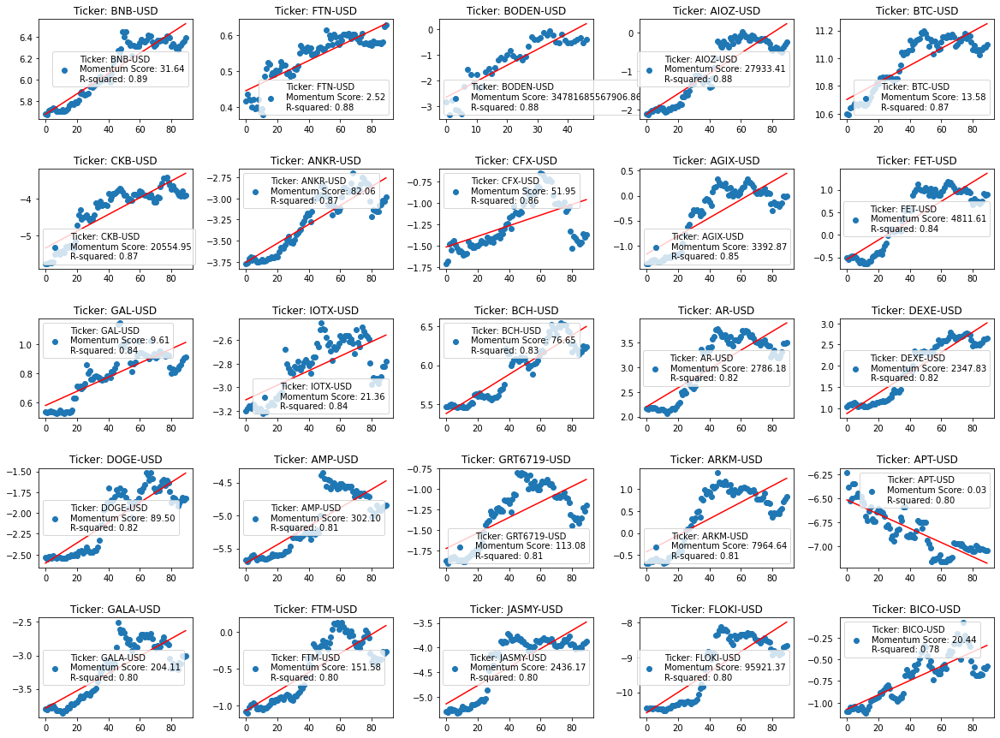

In [33]:
# Assuming momentum_scores_and_r2 is defined and populated as shown in the Cell 1 code

# Sort the momentum_scores_and_r2 dictionary by R-squared values in descending order
sorted_by_r2 = sorted(momentum_scores_and_r2.items(), key=lambda x: x[1][1], reverse=True)

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming close_data and lookback_period are defined as per your original setup

# Create a figure with subplots
fig, axs = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
axs = axs.ravel()  # Flatten the array of subplots

# Iterate over the sorted R-squared scores and plot the scatter plots for the top 25
for i, (ticker, (score, r_squared)) in enumerate(sorted_by_r2[:25]):
    prices = close_data[ticker].dropna()[-lookback_period:]
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = np.array(range(len(log_prices)))
    y_fit = slope * x + intercept
    
    # Plot the scatter plot and the regression line
    ax = axs[i]
    ax.scatter(x, log_prices, label=f'Ticker: {ticker}\nMomentum Score: {score:.2f}\nR-squared: {r_squared:.2f}')
    ax.plot(x, y_fit, 'r-')  # Red line for the linear regression
    ax.set_title(f'Ticker: {ticker}')
    ax.legend()

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.3)

# Show the plot
plt.show()


### 90 day momentum

In [26]:
import numpy as np
from scipy.stats import linregress

# Define the lookback period, the number of trading days, and the number of days to exclude
lookback_period = 90
trading_days = 365
exclude_days = 14

# Assuming close_data is your DataFrame containing stock prices with tickers as column names

# Modified function to calculate both momentum score and R-squared
def calculate_momentum_score_and_r2(prices):
    log_prices = np.log(prices)
    slope, _, r_value, _, _ = linregress(range(len(log_prices)), log_prices)
    momentum_score = (1 + slope)**trading_days * r_value**2
    return momentum_score, r_value**2

# Iterate over each ticker column and calculate the momentum score and R-squared value
momentum_scores_and_r2 = {}
for ticker in close_data.columns:
    prices = close_data[ticker].dropna()
    
    # Select the prices for the regression, excluding the last 'exclude_days' days
    regression_prices = prices[:-exclude_days][-lookback_period:]
    
    # Get both momentum score and R-squared for the ticker
    momentum_score, r_squared = calculate_momentum_score_and_r2(regression_prices)
    
    # Store in the dictionary
    momentum_scores_and_r2[ticker] = (momentum_score, r_squared)

# Sort the momentum scores in descending order
sorted_momentum_scores = sorted(momentum_scores_and_r2.items(), key=lambda x: x[1], reverse=True)
print(sorted_momentum_scores)

[('BODEN-USD', (34781685567906.86, 0.8786298711595965)), ('MEW30126-USD', (198286842441.7312, 0.30544057254456264)), ('DEGEN30096-USD', (5457572313.548644, 0.4778200531393376)), ('ENA-USD', (2038862190.6080184, 0.6754909774246872)), ('BRETT29743-USD', (1743338.29847997, 0.7393063728411218)), ('FLOKI-USD', (95921.36575436151, 0.7957487922583388)), ('AIOZ-USD', (27933.414629609382, 0.875216978011398)), ('CKB-USD', (20554.954593938884, 0.8700385699645656)), ('ARKM-USD', (7964.63678778604, 0.8088605984108047)), ('ETHFI-USD', (6410.927564449854, 0.4508856646264131)), ('FET-USD', (4811.613660864399, 0.8449388062061473)), ('AGIX-USD', (3392.86629703327, 0.8537485026991919)), ('AR-USD', (2786.1814863377062, 0.8173226053967165)), ('JASMY-USD', (2436.166627242116, 0.7975013647247817)), ('DEXE-USD', (2347.8310157926708, 0.8168749917401872)), ('HOT-USD', (2166.3020499591357, 0.7428172345169785)), ('BOME-USD', (666.9499803930781, 0.16352043409299255)), ('AMP-USD', (302.09898086608257, 0.81021742444

C:\Users\James_Rig\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning:

divide by zero encountered in log

C:\Users\James_Rig\anaconda3\lib\site-packages\numpy\lib\function_base.py:2536: RuntimeWarning:

invalid value encountered in subtract



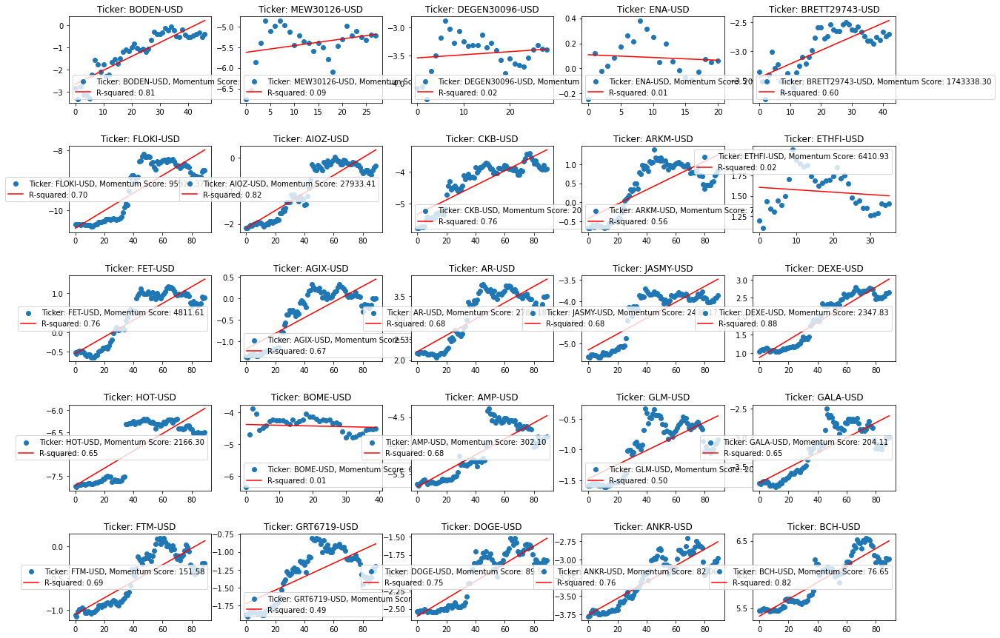

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a figure with subplots
fig, axs = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
axs = axs.ravel()  # Flatten the array of subplots

# Iterate over the sorted momentum scores and plot the scatter plots
for i, (ticker, score) in enumerate(sorted_momentum_scores[:25]):
    prices = close_data[ticker].dropna()[-lookback_period:]
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = range(len(log_prices))
    y_fit = [slope * xi + intercept for xi in x]
    
    # Plot the scatter plot and the r-squared line
    # Plot the scatter plot and the r-squared line
    ax = axs[i]
    ax.scatter(x, log_prices, label=f'Ticker: {ticker}, Momentum Score: {score[0]:.2f}')
    ax.plot(x, y_fit, 'r-', label=f'R-squared: {linregress(x, log_prices)[2]**2:.2f}')
    ax.set_title(f'Ticker: {ticker}')
    ax.legend()


# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.5)

# Show the plot
plt.show()

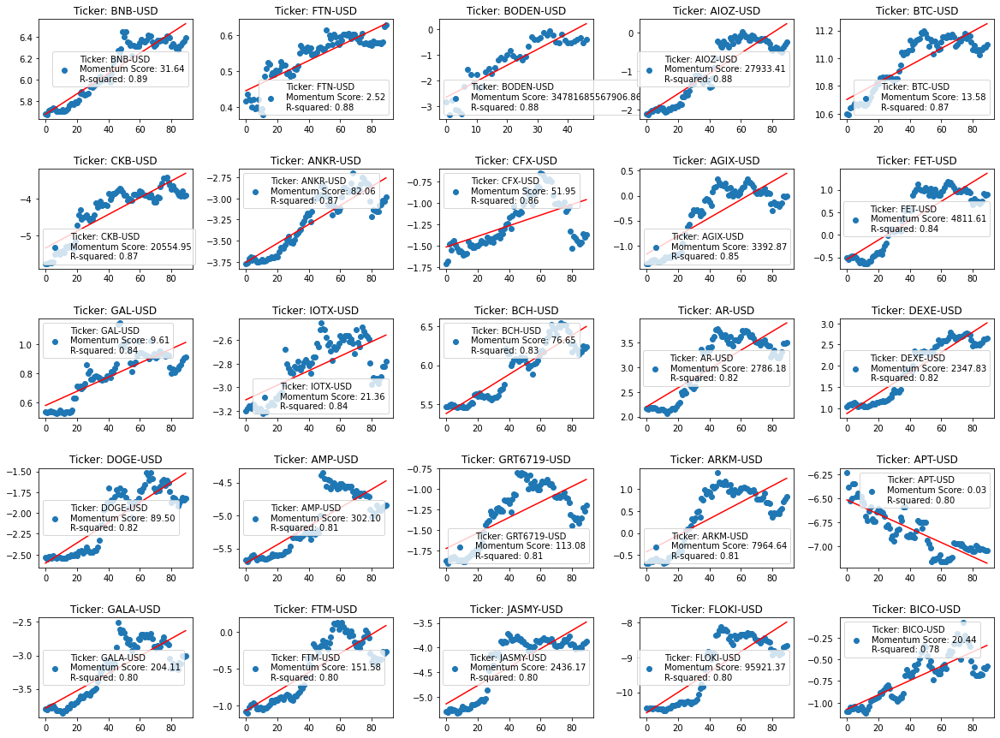

In [28]:
# Assuming momentum_scores_and_r2 is defined and populated as shown in the Cell 1 code

# Sort the momentum_scores_and_r2 dictionary by R-squared values in descending order
sorted_by_r2 = sorted(momentum_scores_and_r2.items(), key=lambda x: x[1][1], reverse=True)

import matplotlib.pyplot as plt
import seaborn as sns

# Assuming close_data and lookback_period are defined as per your original setup

# Create a figure with subplots
fig, axs = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
axs = axs.ravel()  # Flatten the array of subplots

# Iterate over the sorted R-squared scores and plot the scatter plots for the top 25
for i, (ticker, (score, r_squared)) in enumerate(sorted_by_r2[:25]):
    prices = close_data[ticker].dropna()[-lookback_period:]
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = np.array(range(len(log_prices)))
    y_fit = slope * x + intercept
    
    # Plot the scatter plot and the regression line
    ax = axs[i]
    ax.scatter(x, log_prices, label=f'Ticker: {ticker}\nMomentum Score: {score:.2f}\nR-squared: {r_squared:.2f}')
    ax.plot(x, y_fit, 'r-')  # Red line for the linear regression
    ax.set_title(f'Ticker: {ticker}')
    ax.legend()

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.3)

# Show the plot
plt.show()


In [29]:
num_tickers = 25
num_cols = 5
num_rows = num_tickers // num_cols + (num_tickers % num_cols > 0)

# Create a subplot figure with defined rows and columns
fig = make_subplots(rows=num_rows, cols=num_cols, subplot_titles=[t[0] for t in sorted_by_r2[:num_tickers]])

# Iterate over the sorted R-squared scores and plot the scatter plots for the top 25
for i, (ticker, (score, r_squared)) in enumerate(sorted_by_r2[:num_tickers]):
    prices = close_data[ticker].dropna()[-lookback_period:]  # Use actual 'lookback_period'
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = np.array(range(len(log_prices)))
    y_fit = slope * x + intercept
    
    # Calculate subplot position
    row = i // num_cols + 1
    col = i % num_cols + 1
    
    # Add scatter trace
    fig.add_trace(go.Scatter(x=x, y=log_prices, mode='markers', name=f'{ticker} Data'),
                  row=row, col=col)
    
    # Add line trace
    fig.add_trace(go.Line(x=x, y=y_fit, mode='lines', name=f'{ticker} Fit'),
                  row=row, col=col)

# Update layout with titles and adjust spacing
fig.update_layout(
    title='Scatter Plots of Top 25 Tickers with Linear Regression',
    height=300*num_rows,  # Adjust height based on the number of rows
    width=300*num_cols,  # Adjust width based on the number of columns
    showlegend=True
)

# Show the figure
fig.show()

C:\Users\James_Rig\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [30]:
fig = make_subplots(
    rows=num_rows,
    cols=num_cols,
    subplot_titles=[
        f'{ticker} (Score: {score:.2f}, R²: {r_squared:.2f})' for ticker, (score, r_squared) in sorted_by_r2[:num_tickers]
    ]
)

# Iterate over the sorted R-squared scores and plot the scatter plots for the top 25
for i, (ticker, (score, r_squared)) in enumerate(sorted_by_r2[:num_tickers]):
    prices = close_data[ticker].dropna()[-lookback_period:]  # Use actual 'lookback_period'
    log_prices = np.log(prices)
    
    # Calculate the linear regression line
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = np.array(range(len(log_prices)))
    y_fit = slope * x + intercept
    
    # Calculate subplot position
    row = i // num_cols + 1
    col = i % num_cols + 1
    
    # Add scatter trace
    fig.add_trace(go.Scatter(x=x, y=log_prices, mode='markers', name=f'{ticker} Data'),
                  row=row, col=col)
    
    # Add line trace
    fig.add_trace(go.Line(x=x, y=y_fit, mode='lines', name=f'{ticker} Fit'),
                  row=row, col=col)

# Update layout with titles and adjust spacing
fig.update_layout(
    title='Scatter Plots of Top 25 Tickers with Linear Regression',
    height=300*num_rows,  # Adjust height based on the number of rows
    width=300*num_cols,  # Adjust width based on the number of columns
    showlegend=True
)

# Show the figure
fig.show()

In [31]:
# Settings
num_tickers = 25
num_cols = 5
num_rows = num_tickers // num_cols + (num_tickers % num_cols > 0)

# Create subplot figure with adjusted sizes and subplot titles
fig = make_subplots(
    rows=num_rows, cols=num_cols,
    subplot_titles=[
        f'{ticker} (S: {score:.2f}, R²: {r_squared:.2f})' for ticker, (score, r_squared) in sorted_by_r2[:num_tickers]
    ],
    vertical_spacing=0.05,  # Adjust vertical spacing between plots
    horizontal_spacing=0.05  # Adjust horizontal spacing between plots
)

# Plot each data series
for i, (ticker, (score, r_squared)) in enumerate(sorted_by_r2[:num_tickers]):
    prices = close_data[ticker].dropna()[-lookback_period:]  # Use actual 'lookback_period'
    log_prices = np.log(prices)
    
    # Calculate linear regression
    slope, intercept, _, _, _ = linregress(range(len(log_prices)), log_prices)
    x = np.array(range(len(log_prices)))
    y_fit = slope * x + intercept
    
    row = i // num_cols + 1
    col = i % num_cols + 1
    
    # Add scatter and line traces
    fig.add_trace(go.Scatter(x=x, y=log_prices, mode='markers', name=f'{ticker} Data'),
                  row=row, col=col)
    fig.add_trace(go.Line(x=x, y=y_fit, mode='lines', name=f'{ticker} Fit'),
                  row=row, col=col)

# Layout adjustments
fig.update_layout(
    title='Scatter Plots of Top 25 Tickers with Linear Regression',
    height=350*num_rows,  # Increased height based on the number of rows
    width=350*num_cols,  # Increased width based on the number of columns
    showlegend=False,
    font=dict(size=10)  # Reduce font size for better fit
)

# Show the figure
fig.show()